## Utilizzo dell'equazione di Penman-Monteith per il calcolo dell'evapotraspirazione

# Sommario
    
* [Penman Monteith](#Teoria)
* [Evapotraspirazione potenziale](#potential)
* [Evapotraspirazione Effettiva](#actual)
* [Evapotraspirazione Melo](#apple)
* [Clearness Index](#CI)


L'utilizzo del modello di Penman-Monteith per il calcolo dell'evapotraspirazione prevede la risoluzione dell'equazione:
\begin{equation}
\lambda\ ET = \dfrac{\Delta\cdot (R_{n} - G)+\frac{p_{a}\cdot\ c_{p}(e_{s}-e)}{r_{a}}}{\Delta+\gamma\cdot(1+\frac{r_{s}}{r_{a}})}
\end{equation}

La FAO (Organizzazione delle Nazioni Unite per l'Ambiente e l'Agricoltura) ha inoltre introdotto una formulazione che tenga conto anche dei fenomeni di stress e in particolare del termine $kc$, dovuto alla vegetazione, e $ks$, coefficiente che tiene invece conto del contenuto di acqua nel suolo. Entrambi questi coefficienti sono ricavabili dalla tabella fornita dalla FAO stessa

In questo caso la relazione diventa:
\begin{equation}
ET_{0}^{FAO} =  K_{s} \cdot K_{c} \cdot \dfrac{0.408\cdot \Delta\cdot (R_{n} - G)+\gamma\cdot u_{2}\cdot(e_{s}-e)\cdot\frac{C_{p}}{T+273}}{\Delta+\gamma\cdot(1+C_{d}\cdot u_{2})}
\end{equation}

Dove:
- $ET$ è espresso in [$mm \cdot day^{−1}$] o [$mm\cdot h^{−1}$]; 
- $K_{s}$ = coefficiente stress dovuto alla mancanza di acqua.
- $K_{c}$ = coefficiente del campo, 
- $R_{n}$ = radiazione netta in [$MJ \cdot m^{2} \cdot d^{−1}$] o [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $G$ = flusso di calore al suolo. Prende valori diversi per la notte e per il giorno [$MJ \cdot m^{2} \cdot day^{−1}$] o [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $T$ = temperatura media giornaliera o oraria dell'aria (°C) ; 
- $u_{2}$ = velocità del vento espressa in ($m\cdot s^{−1}$); 
- $e_{s}$ = saturazione media di tensione di vapore in ($kP_{a}$); 
- $e$ = media effettiva tensione di vapore; 
- $\Delta$ = pendenza della curva di vapore espressa in ($kP_{a}\dot °C^{−1}$); 
- $\gamma$ = costante psicometrica espressa in in ($kP_{a} \cdot$ °$C^{−1}$); 
- $C_{d}$ = coefficiente pari a 0.34 
- $C_{p}$ = coefficiente pari a 900 se si prende come invervallo quello giornaliero e uguale a 37 se si prende quello orario.

Per questa simulazione è stata presa in considerazione sempre una foresta di conifere situata in prossimità del centroide per la stazione di Cavone, in modo da poter poi confrontare i risultati con quelli ottenuti dal modello di Priestley-Taylor. L'altezza stimata per questo tipo di vegetazione è di 10m, la massima profondità delle radici è di 1.0 - 1.5m così come riportato nelle tabelle della FAO. La tipologia di suolo è la stessa già descritta per il modello di Priestley - Taylor e per questo i parametri non cambiano.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import plotly.express as px
import plotly.graph_objects as go
import os
from GEOSPACE_Output import*
import plotly.graph_objects as go
oms_project_path = os.path.dirname(os.getcwd())
from IPython.display import Image

In [2]:
os.chdir(os.path.join(os.getcwd(), "..", "output", "Cavone", "1"))
#os.listdir()

## Evapotraspirazione Potenziale <a class='anchor' id='potential'> </a>

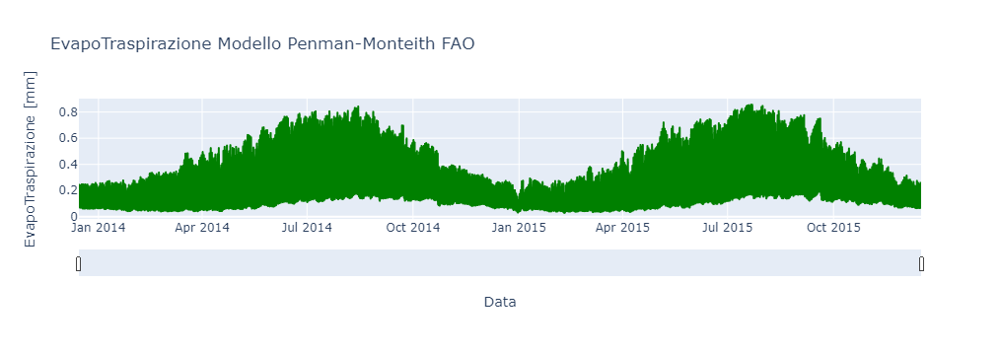

In [3]:
df = pd.read_csv('ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione Modello Penman-Monteith FAO')
fig.update_traces(line_color='green')
fig.update_xaxes(rangeslider_visible=True)
fig.show()


Come si può osservare dal grafico l'andamento dell'Evapotraspirazione secondo il modello di Penman-Monteith prende valori molto variabili a seconda della stagione per quello che riguarda un eventuale conifera posizionata in prossimità di Cavone, con degli evidenti minimi in Inverno.

é poi possibile rappresentare con anche il calore latente, confrontando nuovamente i risultati ottenuti col modello della FAO e quelli con Priestley-Taylor:

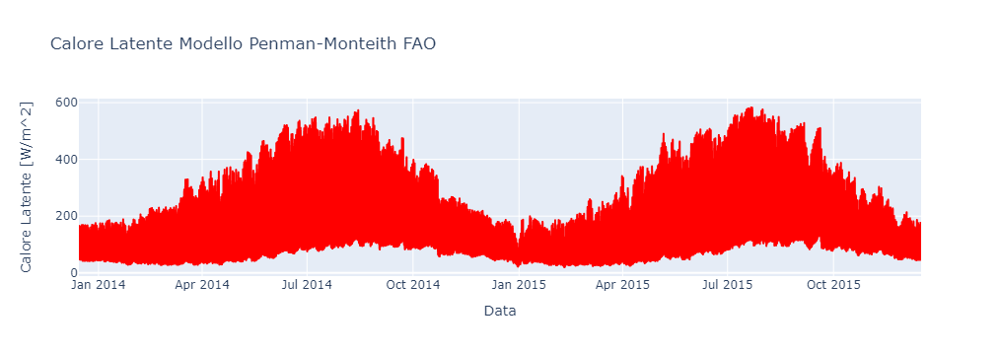

In [4]:
df2 = pd.read_csv('LH_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Data','Calore Latente [W/m^2]']
fig = px.line(df2, x='Data', y='Calore Latente [W/m^2]', title='Calore Latente Modello Penman-Monteith FAO')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

L'andamento del calore latente (espresso in W/m$^{2}$) segue quello che è già stato osservato per l'evapotraspirazione.

La trattazione continua considerando poi non solo i valori di Evapotraspirazione in condizioni ottimali, ma quelli che effettivamente si trovano a causa del contenuto d'acqua nel suolo, di fattori ambientali vari o semplicemente della vegetazione presente.
Si fanno, quindi, più esempi per osservare come si modificano i risultati prendendo in considerazione ad esempio il solo termine di stress dovuto al contenuto di acqua nel suolo, tenendo conto di quello dovuto a varie condizioni ambientali (come lo stress dovuto alla radiazione, il Vapure Pressure Deficit o la temperatura) e infine considerando tutti questi fattori contemporaneamente.

## Evapotraspirazione Effettiva <a class='anchor' id='actual'> </a>

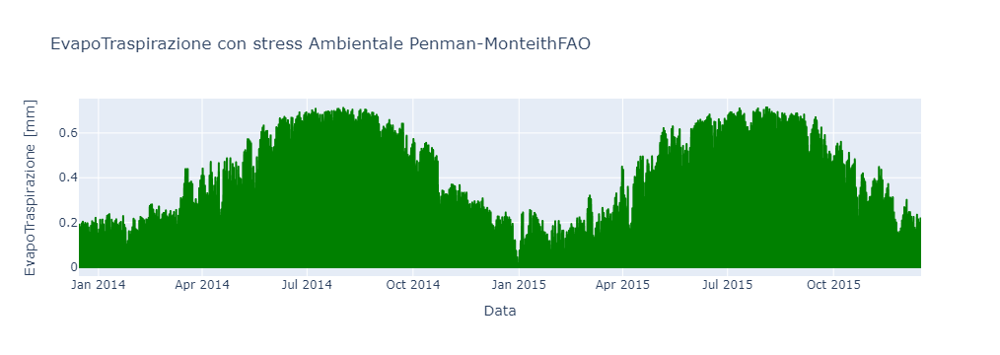

In [5]:
df3 = pd.read_csv('env_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df3, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione con stress Ambientale Penman-MonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Tenendo conto anche solo dello stress dovuto a fenomeni ambientali l'evapotraspirazione passa da un massimo di 0.8mm a un massimo di 0.6mm.
La differenza risulta ancora più importante se teniamo conto anche dello stress idrico nel calcolo dell'evapotraspirazione, come si può osservare dai seguenti grafici:

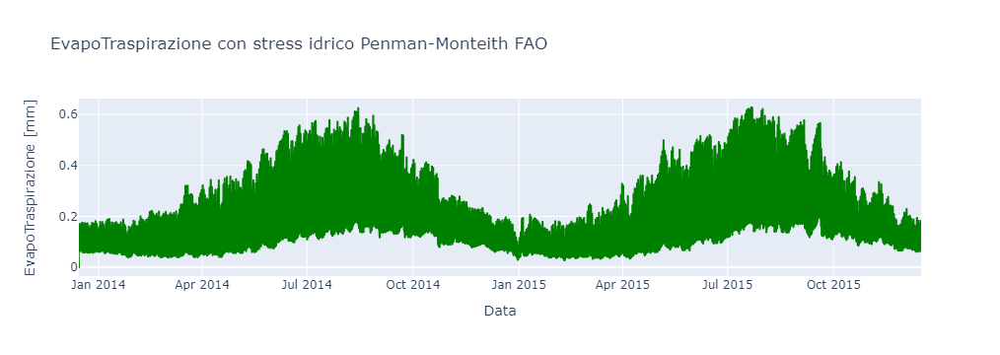

In [6]:
df4 = pd.read_csv('wat_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df4, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione con stress idrico Penman-Monteith FAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Teniamo poi conto di tutti i fattori che possono influenzare l'Evapotraspirazione contemporaneamente e notiamo una netta diminuzione rispetto ai valori iniziali:

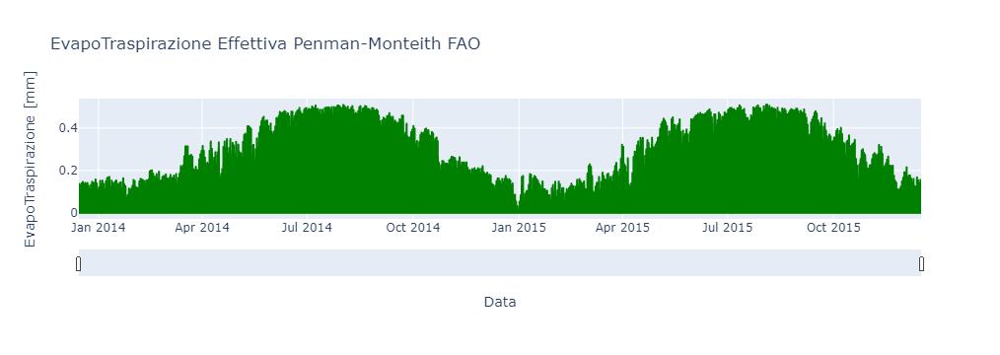

In [7]:
df5 = pd.read_csv('tot_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df5, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione Effettiva Penman-Monteith FAO')
fig.update_traces(line_color='green')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

Riportiamo poi il risultato già ricavato con Pristley Taylor per paragonare, in seguito, i grafici:

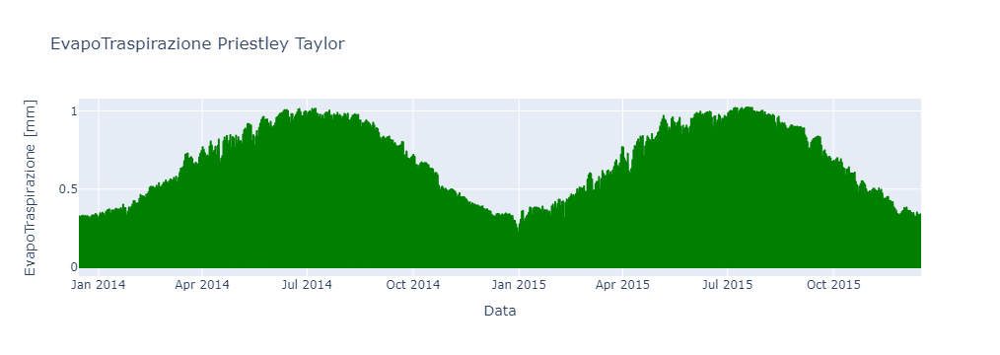

In [8]:
df1 = pd.read_csv('ET_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df1.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df1, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione Priestley Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Per visualizzare i risultati in modo più chiaro confrontiamo prima i risultati dell'Evapotraspirazione calcolata con Priestley-Taylor e quella calcolata con Penman Monteith in assenza di stress e in presenza di tutti gli stress:

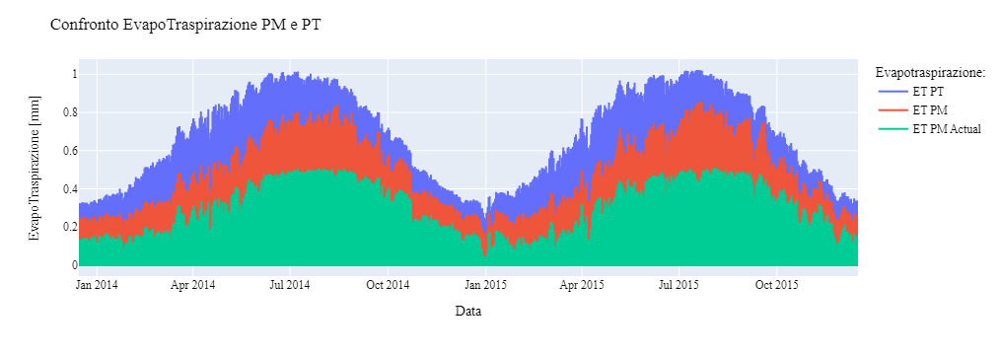

In [9]:
fig = px.line()
fig.add_trace(go.Scatter(x=df1['Data'], y=df1['EvapoTraspirazione [mm]'], mode='lines', name='ET PT'))
fig.add_trace(go.Scatter(x=df['Data'], y=df['EvapoTraspirazione [mm]'], mode='lines', name='ET PM'))
fig.add_trace(go.Scatter(x=df3['Data'], y=df5['EvapoTraspirazione [mm]'], mode='lines', name='ET PM Actual'))

fig.update_layout(
    title='Confronto EvapoTraspirazione PM e PT ',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    legend_title="Evapotraspirazione:",
    font=dict(size=12))
fig.show()

Confrontiamo infine i risultati ottenuti con Penman-Monteith in assenza e in presenza dei vari tipi di stress

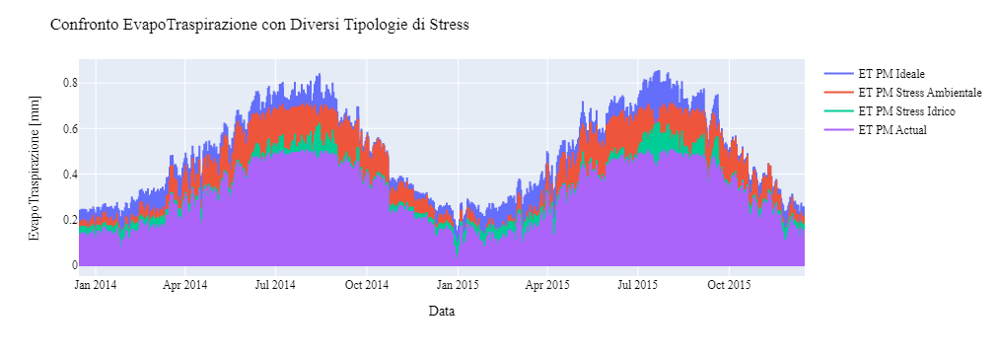

In [10]:
fig = px.line()
fig.add_trace(go.Scatter(x=df['Data'], y=df['EvapoTraspirazione [mm]'], mode='lines', name='ET PM Ideale'))
fig.add_trace(go.Scatter(x=df3['Data'], y=df3['EvapoTraspirazione [mm]'], mode='lines', name='ET PM Stress Ambientale'))
fig.add_trace(go.Scatter(x=df4['Data'], y=df4['EvapoTraspirazione [mm]'], mode='lines', name='ET PM Stress Idrico'))
fig.add_trace(go.Scatter(x=df5['Data'], y=df5['EvapoTraspirazione [mm]'], mode='lines', name='ET PM Actual'))

fig.update_layout(
    title='Confronto EvapoTraspirazione con Diversi Tipologie di Stress',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

## Evapotraspirazione Melo <a class='anchor' id='apple'> </a>

Altra interessante osservazione potrebbe essere quella di confrontare i risultati ricavati nel caso delle conifere con quelli che potremmo avere con un'altra tipologia di pianta, sullo stesso tipo di suolo.
A questo proposito si è scelto un melo, con coefficienti:

- $p$ (depletion fraction) = 0.50
- profondità delle radici = 1.5m

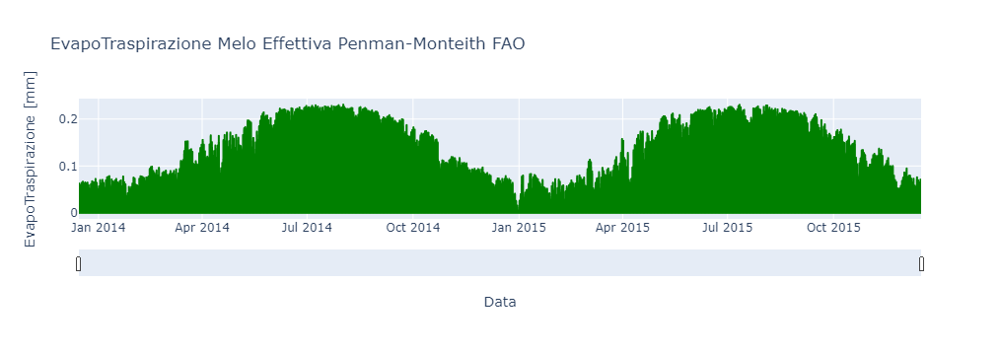

In [11]:
df6 = pd.read_csv('app_tot_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df6, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione Melo Effettiva Penman-Monteith FAO')
fig.update_traces(line_color='green')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

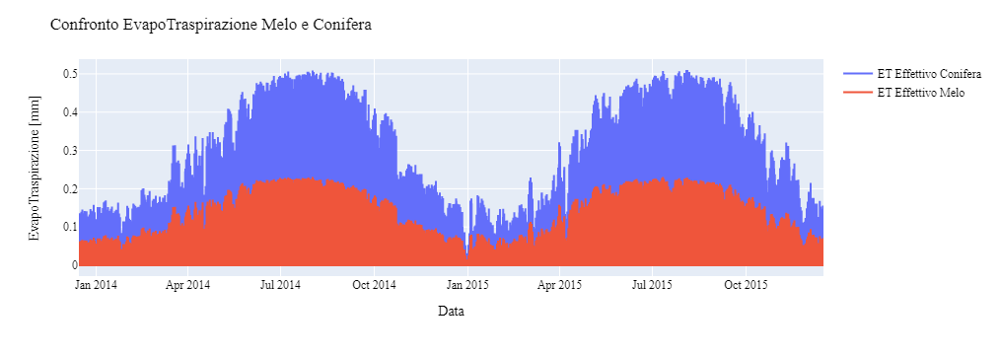

In [12]:
fig = px.line()
fig.add_trace(go.Scatter(x=df5['Data'], y=df5['EvapoTraspirazione [mm]'], mode='lines', name='ET Effettivo Conifera'))
fig.add_trace(go.Scatter(x=df6['Data'], y=df6['EvapoTraspirazione [mm]'], mode='lines', name='ET Effettivo Melo'))

fig.update_layout(
    title='Confronto EvapoTraspirazione Melo e Conifera',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Visualizzando poi entrambe le piante nello stesso grafico possiamo vedere in modo evidente che, nonostante siano entrambe piante caratterizzate da una certa altezza, l'evapotraspirazione di una conifera (tenendo conto anche dei fattori di stress) a parità di suolo è nettamente maggiore.
Questo è probabilmente dovuto alla dimensione della conifera, mediamente maggiore di qualche metro e il conseguente maggiore tasso di intercettazione delle precipitazioni che le contraddistingue.

# Modello di Penman - Monteith tenendo conto del Clearness Index <a class='anchor' id='CI'> </a>

Un'altra modifica interessante che si può fare rispetto alla trattazione iniziale è quella di tener conto del Clearness Index, CI, quindi del grado di copertura da parte delle nuvole del cielo. Questo fattore può influenzare anche visibilmente i risultati in quanto va a cambiare il valore della radiazione da considerare nel calcolo dell'Evapotraspirazione.

Il CI è dato da il rappporto tra la radiazione a onda corta misurata e la radiazione che arriva al top dell'atmosfera simulata da un modello. è un indice che varia tra 0 a 1 a seconda di quanto il cielo è limpido.
Per il calcolo è necessario conoscere quindi sia i dati di radiazione misurati e un modello per avere la radiazione al top dell'atmosfera.

Per la simulazione seguente, non essendo disponibili dati effettivamenti misurati dalla stazione, è stato preso un file di esempio ($Measured$) per calcolare il CI e quindi la radiazione netta.

Osserviamo quindi gli output dopo esserci posizionati nella cartella corretta:

In [13]:
os.chdir(oms_project_path + '/data/Cavone/1')

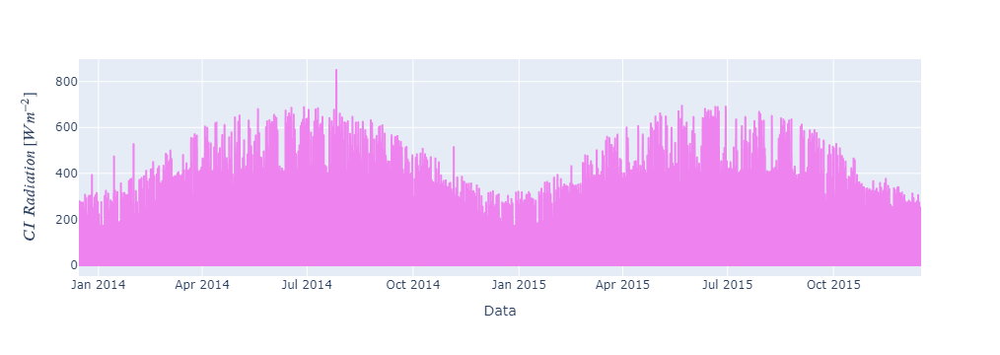

In [14]:
df7 = pd.read_csv('Net_allsky_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df7.columns = ['Data','CI Radiation']
fig = px.line(df7, x='Data', y='CI Radiation')
fig.update_traces(line_color='violet')
fig.update_yaxes(title_text='$CI\ Radiation \\ [W m^{−2}]$')
fig.show()

Dopo aver trovato la radiazione si può andare a modificare il sim file di Penman Monteith, dove tra i paramentre di input era infatti stata inserita anche la radiazione netta. Si sostituisce quindi la radiazione netta con quella appena calcolata.

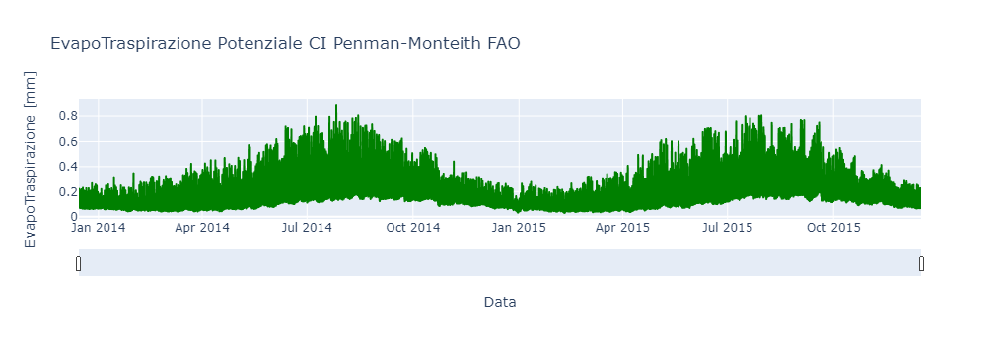

In [15]:
df8 = pd.read_csv('CI_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df8.columns = ['Data','EvapoTraspirazione [mm]']
fig = px.line(df8, x='Data', y='EvapoTraspirazione [mm]', title='EvapoTraspirazione Potenziale CI Penman-Monteith FAO')
fig.update_traces(line_color='green')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

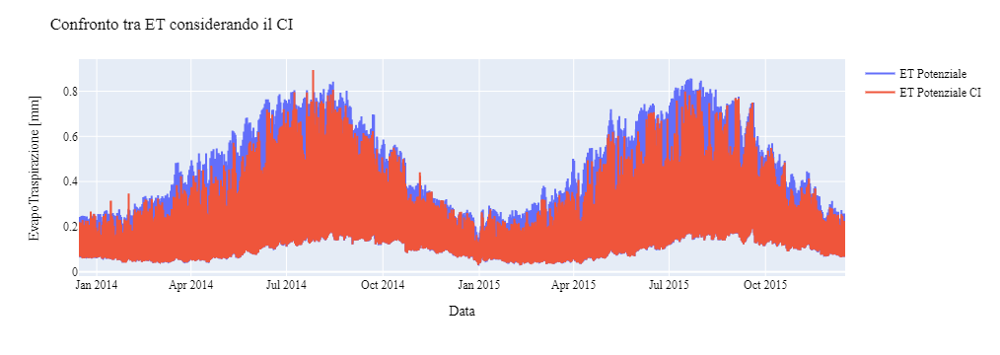

In [16]:
fig = px.line()

fig.add_trace(go.Scatter(x=df['Data'], y=df['EvapoTraspirazione [mm]'], mode='lines', name='ET Potenziale'))
fig.add_trace(go.Scatter(x=df8['Data'], y=df8['EvapoTraspirazione [mm]'], mode='lines', name='ET Potenziale CI'))

fig.update_layout(
    title='Confronto tra ET considerando il CI',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Si considera quindi il confronto tra l'Evapotraspirazione Potenziale calcolata come fatta prima e l'Evapotraspirazione calcolata invece, sempre con Penman Monteith, ma tenendo conto della copertura del cielo da parte delle nuvole.

Il risultato rappresentato nel grafico prende ancora più significato se si osserva che, tenendo conto del CI, l'Evapotraspirazione presenta due picchi nel corso della giornata e rispecchia quindi in modo molto più veriterio la realtà, come è mostrato nella foto estratta da uno zoom del grafico superiore:

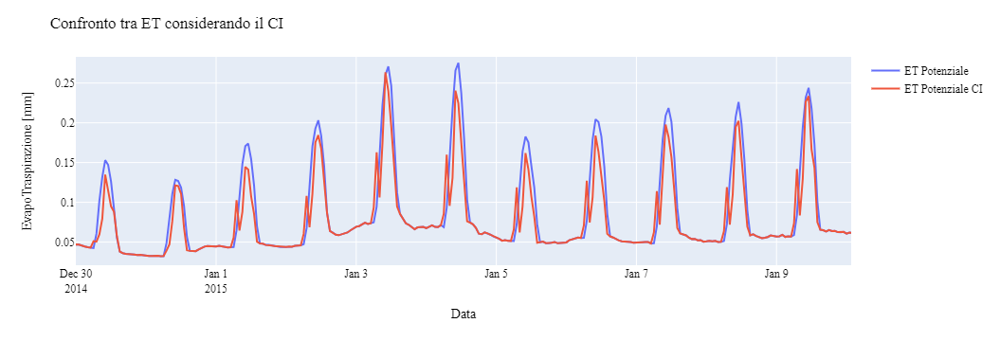

In [17]:
Image("/Users/titab/Desktop/Test_GEOframe_verona/OMS_Project_GEOET11/Images/CI_zoom.png")